##Import the Libraries

In [1]:
#The following libraries are required to run this notebook

%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import geopy.distance
from math import radians,cos,sin,asin,sqrt
import folium
import datetime
from folium.plugins import HeatMap
from scipy.stats import ttest_ind

matplotlib.rcParams.update({'font.size': 12})

##Reading the uber dataset

In [2]:
uber_data = pd.read_csv('/content/uber-raw-data-jun14.csv')

In [3]:
# Print the first 10 elements
uber_data.head(10)

,Date/Time,Lat,Lon,Base
0,6/1/2014 0:00:00,40.7293,-73.9920,B02512
1,6/1/2014 0:01:00,40.7131,-74.0097,B02512
2,6/1/2014 0:04:00,40.3461,-74.6610,B02512
3,6/1/2014 0:04:00,40.7555,-73.9833,B02512
4,6/1/2014 0:07:00,40.6880,-74.1831,B02512
5,6/1/2014 0:08:00,40.7152,-73.9917,B02512
6,6/1/2014 0:08:00,40.7282,-73.9910,B02512
7,6/1/2014 0:08:00,40.3042,-73.9794,B02512
8,6/1/2014 0:09:00,40.7270,-73.9915,B02512
9,6/1/2014 0:10:00,40.7221,-73.9965,B02512


In [4]:
#print the type of data in Date/Time
type(uber_data.loc[0,'Date/Time'])

str

In [5]:
#convert it to datetime format for easy indexing
uber_data['Date/Time'] = pd.to_datetime(uber_data['Date/Time'])

In [6]:
#create a new column to store this new binned column
uber_data['BinnedHour']=uber_data['Date/Time'].dt.floor('15min')

In [7]:
#printing the new column - BinnedHour
uber_data['BinnedHour']

,BinnedHour
0,2014-06-01 00:00:00
1,2014-06-01 00:00:00
2,2014-06-01 00:00:00
3,2014-06-01 00:00:00
4,2014-06-01 00:00:00
...,...
408405,2014-06-23 18:15:00
408406,2014-06-23 18:15:00
408407,2014-06-23 18:15:00
408408,2014-06-23 18:15:00


##Visualizing the Dataset

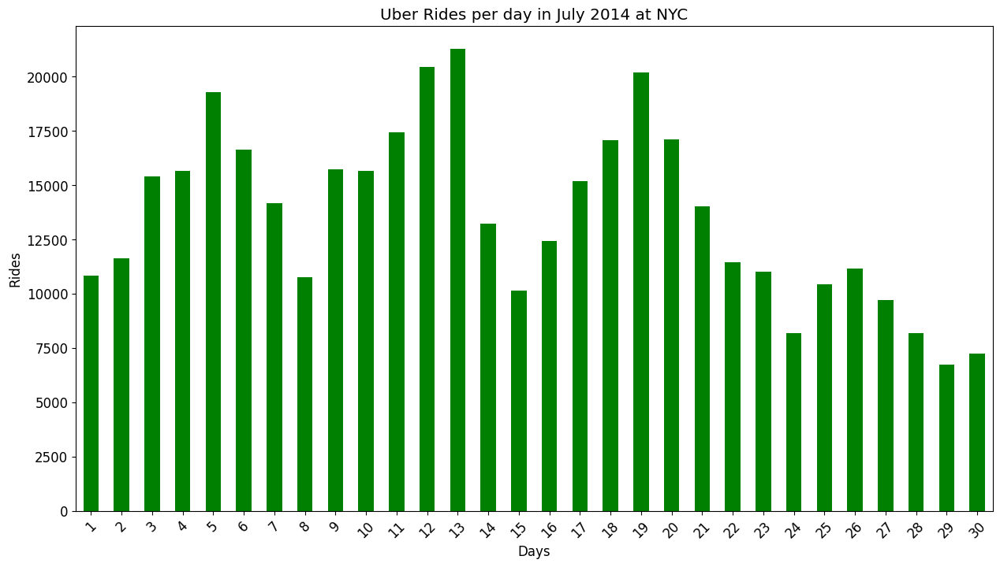

In [8]:
# visualize the total uber rides per day in the month of July 2014
plt.figure(figsize=(15,8))
uber_data['BinnedHour'].dt.day.value_counts().sort_index().plot(kind='bar',color='green')
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)
plt.title('Uber Rides per day in July 2014 at NYC')
plt.xlabel('Days')
_=plt.ylabel('Rides')

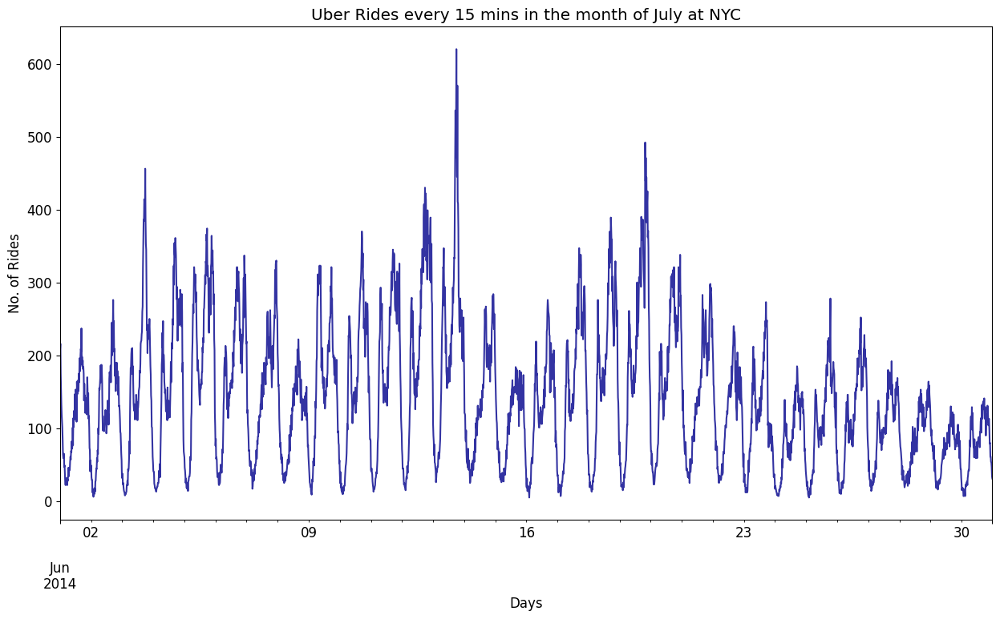

In [10]:
#Uber Rides every 15 mins in the month of July at NYC
plt.figure(figsize=(15,8))
uber_data['BinnedHour'].value_counts().sort_index().plot(c='darkblue',alpha=0.8)
plt.title('Uber Rides every 15 mins in the month of July at NYC')
plt.xlabel('Days')
_=plt.ylabel('No. of Rides')

In [11]:
#Which times correspond to the highest and lowest peaks in the plot above?
uber_data['BinnedHour'].value_counts()

,count
BinnedHour,
2014-06-13 18:00:00,620
2014-06-13 18:45:00,570
2014-06-13 17:15:00,536
2014-06-13 17:45:00,525
2014-06-13 18:15:00,493
...,...
2014-06-30 01:45:00,7
2014-06-02 02:00:00,7
2014-06-02 01:45:00,6


## Visualize the week wise trends in the data

In [12]:
#defining a dictionary to map the weekday to day name
DayMap={0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'}
uber_data['Day']=uber_data['BinnedHour'].dt.weekday.map(DayMap)

In [13]:
#Separating the date to another column
uber_data['Date']=uber_data['BinnedHour'].dt.date

In [14]:
#Defining ordered category of week days for easy sorting and visualization
uber_data['Day']=pd.Categorical(uber_data['Day'],categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],ordered=True)

In [15]:
#Separating time from the "BinnedHour" Column
uber_data['Time']=uber_data['BinnedHour'].dt.time

##Rearranging the dataset for weekly analysis

In [16]:
weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna().rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()
weekly_data.head(10)

/tmp/ipython-input-393561870.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  weekly_data = uber_data.groupby(['Date','Day','Time']).count().dropna().rename(columns={'BinnedHour':'Rides'})['Rides'].reset_index()


,Date,Day,Time,Rides
0,2014-06-01,Monday,00:00:00,0
1,2014-06-01,Monday,00:15:00,0
2,2014-06-01,Monday,00:30:00,0
3,2014-06-01,Monday,00:45:00,0
4,2014-06-01,Monday,01:00:00,0
5,2014-06-01,Monday,01:15:00,0
6,2014-06-01,Monday,01:30:00,0
7,2014-06-01,Monday,01:45:00,0
8,2014-06-01,Monday,02:00:00,0
9,2014-06-01,Monday,02:15:00,0


Grouping weekly_data by days to plot total rides per week in july 2014

In [20]:
daywise = weekly_data.groupby('Day')['Rides'].sum()
daywise

/tmp/ipython-input-799109908.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  daywise = weekly_data.groupby('Day')['Rides'].sum()


,Rides
Day,
Monday,58035
Tuesday,54424
Wednesday,60608
Thursday,71096
Friday,64690
Saturday,49594
Sunday,49963


/tmp/ipython-input-4209691694.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=daywise.index, y=daywise.values, palette='viridis')


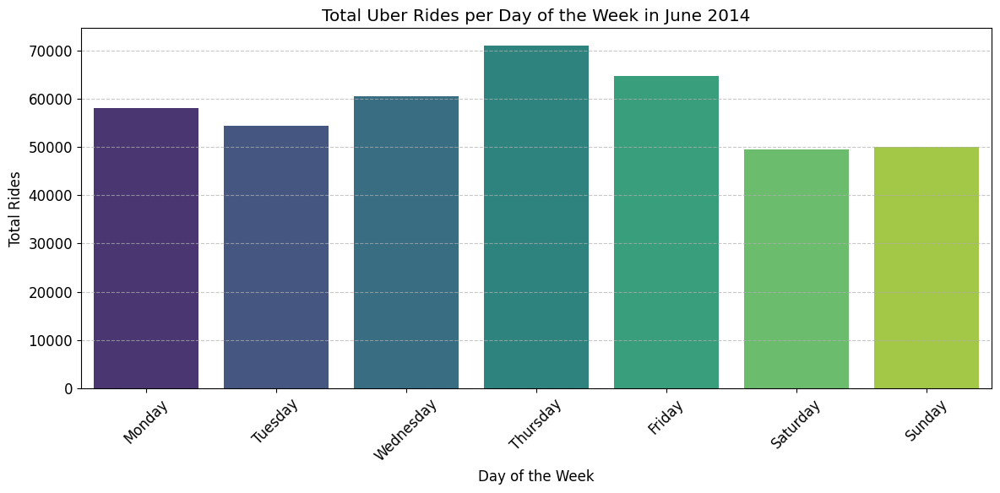

In [19]:
plt.figure(figsize=(12, 6))
sns.barplot(x=daywise.index, y=daywise.values, palette='viridis')
plt.title('Total Uber Rides per Day of the Week in June 2014')
plt.xlabel('Day of the Week')
plt.ylabel('Total Rides')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

/tmp/ipython-input-1787927759.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax=sns.barplot(x = daywise.index,y= vals,palette=colorPal)
/tmp/ipython-input-1787927759.py:13: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  ax=sns.barplot(x = daywise.index,y= vals,palette=colorPal)


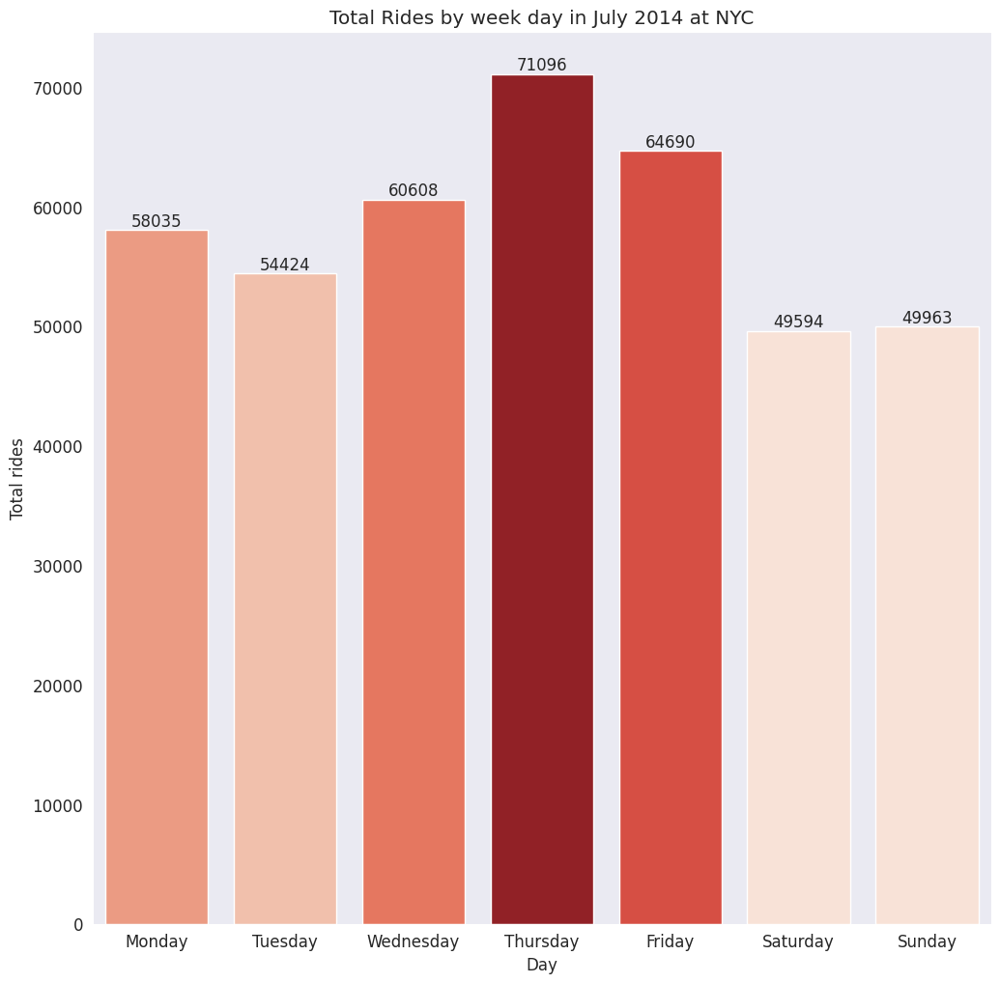

In [21]:
#Plotting the graphs for a better visualization
sns.set_style("dark")
plt.figure(figsize=(12,12))

#Creating a customized color palette for custom hue according to height of bars
vals = daywise.to_numpy().ravel()
normalized = (vals - np.min(vals)) / (np.max(vals) - np.min(vals))
indices = np.round(normalized * (len(vals) - 1)).astype(np.int32)
palette = sns.color_palette('Reds', len(vals))
colorPal = np.array(palette).take(indices, axis=0)

#Creating a bar plot
ax=sns.barplot(x = daywise.index,y= vals,palette=colorPal)
plt.ylabel('Total rides')
plt.title('Total Rides by week day in July 2014 at NYC')
for rect in ax.patches:
    ax.text(rect.get_x() + rect.get_width()/2.0,rect.get_height(),int(rect.get_height()), ha='center', va='bottom')

In [28]:
#Unstacking the data to create heatmap
weekly_data= weekly_data.unstack(level=0)
weekly_data

Day,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
Time,,,,,,,
00:00:00,5.933333,4.266667,5.833333,8.800000,11.033333,22.633333,30.166667
00:15:00,4.900000,3.966667,4.900000,6.833333,9.466667,18.300000,28.400000
00:30:00,5.033333,3.700000,4.766667,5.600000,8.833333,15.466667,24.100000
00:45:00,3.533333,2.400000,4.200000,5.433333,6.966667,14.733333,23.200000
01:00:00,3.033333,2.533333,3.133333,4.566667,7.666667,13.900000,20.300000
...,...,...,...,...,...,...,...
22:45:00,12.800000,14.533333,20.166667,34.866667,33.200000,33.566667,16.200000
23:00:00,10.600000,13.700000,18.733333,27.833333,30.900000,33.066667,12.666667
23:15:00,10.100000,10.466667,13.066667,24.966667,30.800000,29.900000,9.600000


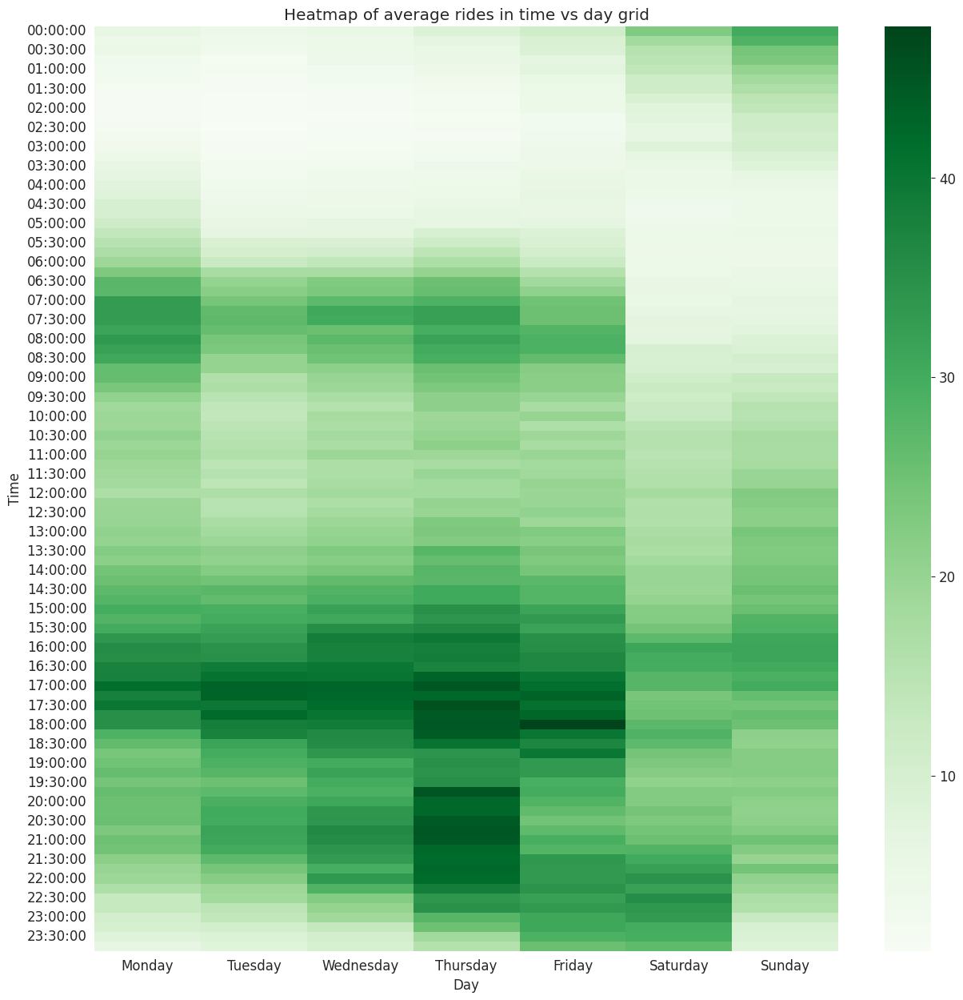

In [29]:
#Heatmap of average rides in time vs day grid
plt.figure(figsize=(15,15))
sns.heatmap(weekly_data,cmap='Greens')
_=plt.title('Heatmap of average rides in time vs day grid')

The heatmap indicates that the maximum average uber rides occur around 5:30PM to 6:15PM on Wednesdays and Thursdays and their values fall between 550 to 620.


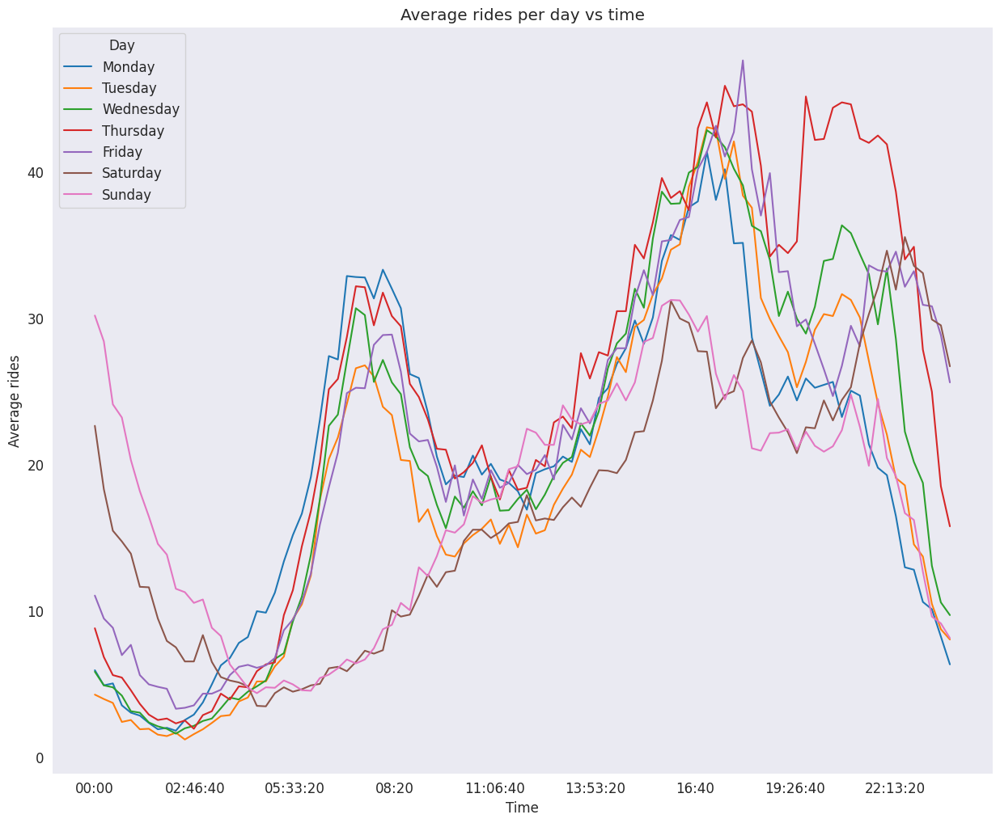

In [30]:
#Average rides per day vs time
plt.figure(figsize=(15,12))
weekly_data.plot(ax=plt.gca())
_=plt.title('Average rides per day vs time')
_=plt.ylabel('Average rides')
plt.locator_params(axis='x', nbins=10)

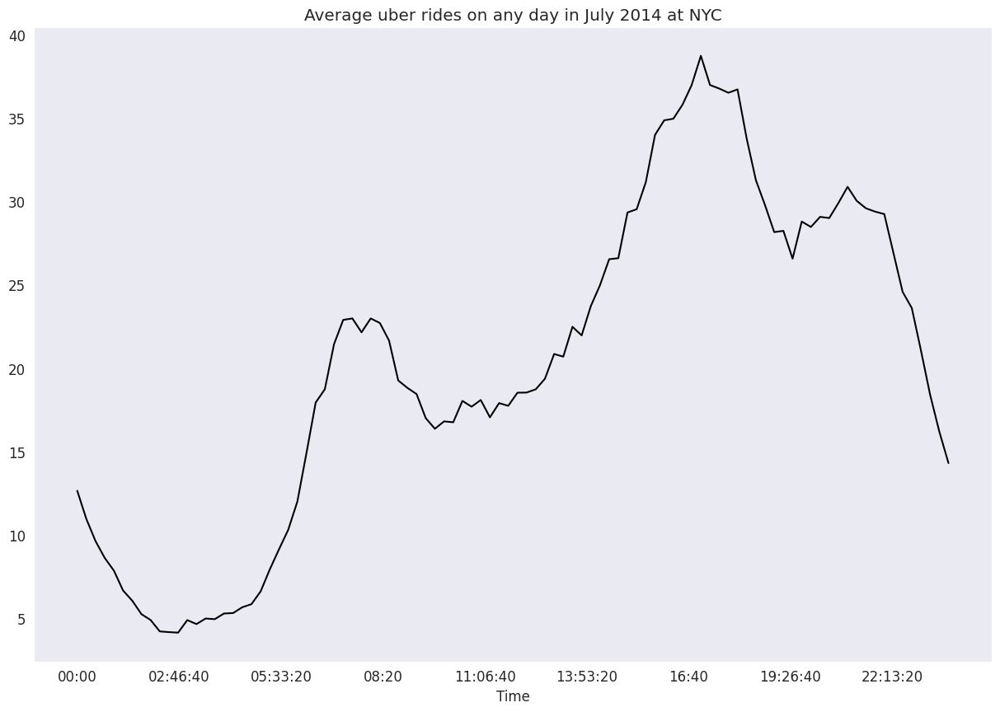

In [31]:
#Finding average rides on any day
plt.figure(figsize=(15,10))
weekly_data.T.mean().plot(c = 'black')
_=plt.title('Average uber rides on any day in July 2014 at NYC')
plt.locator_params(axis='x', nbins=10)

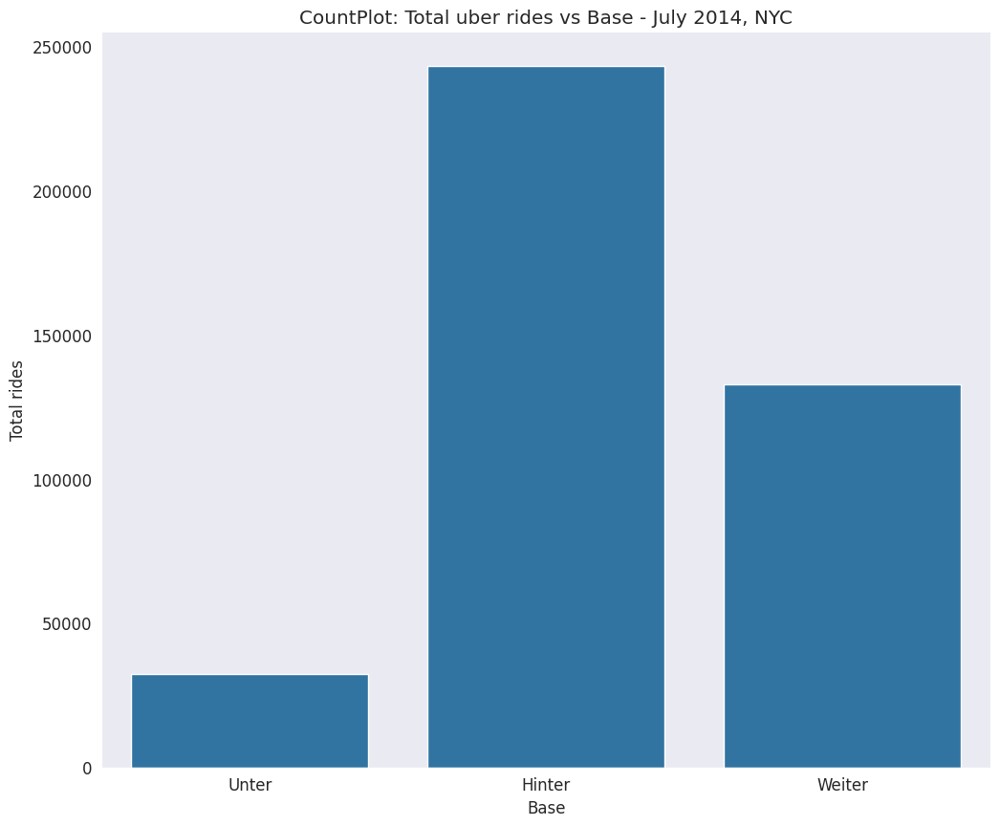

In [32]:
#A mapper to map base number with its name
BaseMapper={'B02512' : 'Unter', 'B02598' : 'Hinter', 'B02617' : 'Weiter', 'B02682' : 'Schmecken','B02764' : 'Danach-NY'}

#Count plot of Base
plt.figure(figsize=(12,10))
sns.set_style("dark")
_=sns.countplot(x=uber_data['Base'].map(BaseMapper))
plt.ylabel('Total rides')
_=plt.title('CountPlot: Total uber rides vs Base - July 2014, NYC')

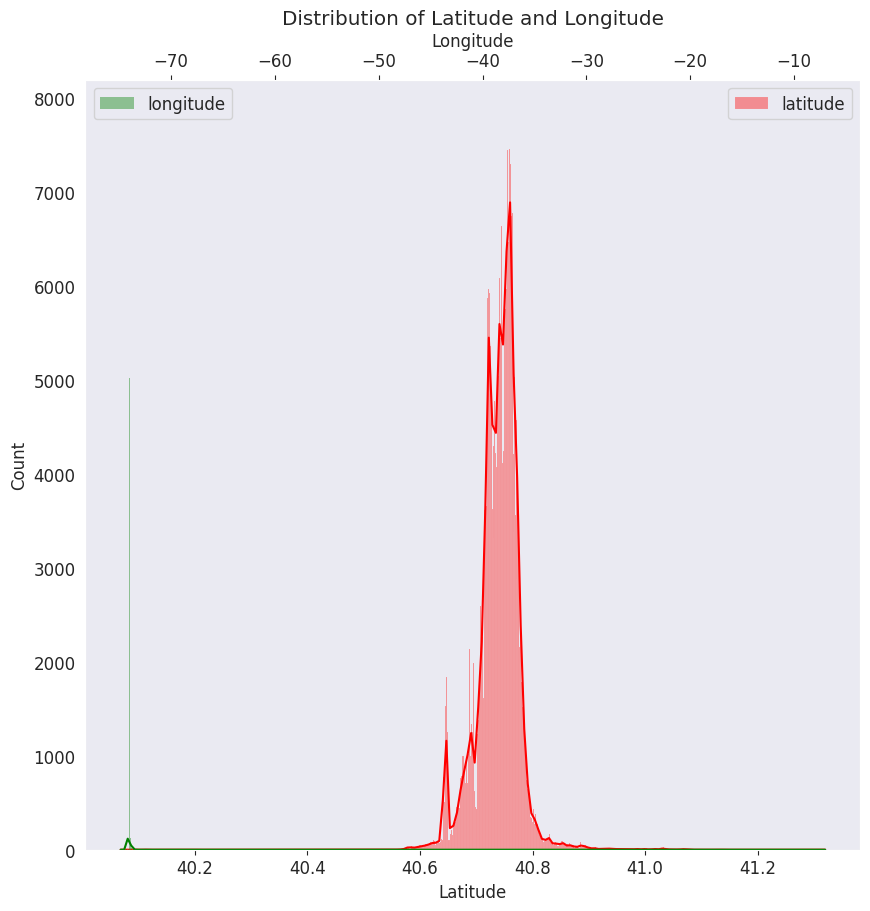

In [33]:
plt.figure(figsize=(10,10))
sns.histplot(uber_data['Lat'], bins='auto',kde=True,color='r',alpha=0.4,label = 'latitude')
plt.legend(loc='upper right')
plt.xlabel('Latitude')
plt.twiny()
sns.histplot(uber_data['Lon'], bins='auto',kde=True,color='g',alpha=0.4,label = 'longitude')
_=plt.legend(loc='upper left')
_=plt.xlabel('Longitude')
_=plt.title('Distribution of Latitude and Longitude')

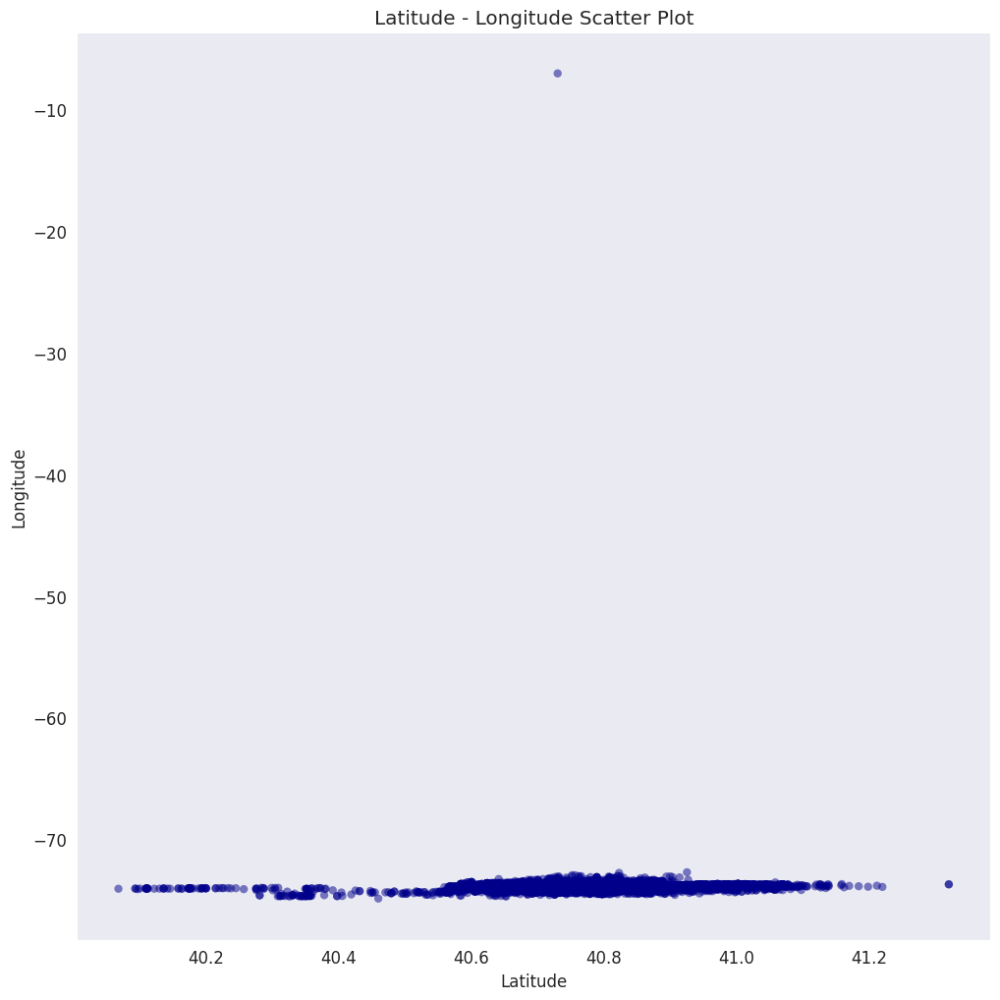

In [34]:
#display the latitude - longitude information in 2D:

plt.figure(figsize=(12,12))
sns.scatterplot(x='Lat',y='Lon',data=uber_data,edgecolor='None',alpha=0.5,color='darkblue')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
_=plt.title('Latitude - Longitude Scatter Plot')

In [35]:
#calculate the distance between Metropolitan Museum and Emperical State Building

metro_art_coordinates = (40.7794,-73.9632)
empire_state_building_coordinates = (40.7484,-73.9857)

distance = geopy.distance.distance(metro_art_coordinates,empire_state_building_coordinates)

print("Distance = ",distance)

Distance =  3.9319431838520242 km


In [36]:
def haversine(coordinates1,coordinates2):

    lat1=coordinates1[0]
    lon1=coordinates1[1]
    lat2=coordinates2[0]
    lon2=coordinates2[1]

    #convert to radians and apply haverson formula
    lon1,lat1,lon2,lat2 = map(radians,[lon1,lat1,lon2,lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = sin(dlat/2)**2 + cos(lat1)*cos(lat2)*sin(dlon/2)**2
    c = 2*asin(sqrt(a))
    r = 3956
    return c*r
print("Distance (mi) = ",haversine(metro_art_coordinates,empire_state_building_coordinates))

Distance (mi) =  2.442501323483997


In [37]:
#calculating distance to MM and ESB for each point in the dataset
uber_data['Distance MM'] = uber_data[['Lat','Lon']].apply(lambda x: haversine(metro_art_coordinates,tuple(x)),axis=1)
uber_data['Distance ESB'] = uber_data[['Lat','Lon']].apply(lambda x: haversine(empire_state_building_coordinates,tuple(x)),axis=1)

In [38]:
#printing the first 10 elements of the updated dataset
uber_data.head(10)

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB
0,2014-06-01 00:00:00,40.7293,-73.9920,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,3.772908,1.359325
1,2014-06-01 00:01:00,40.7131,-74.0097,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,5.183800,2.741757
2,2014-06-01 00:04:00,40.3461,-74.6610,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,47.272774,45.020108
3,2014-06-01 00:04:00,40.7555,-73.9833,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,1.956493,0.506038
4,2014-06-01 00:07:00,40.6880,-74.1831,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,13.122094,11.140215
5,2014-06-01 00:08:00,40.7152,-73.9917,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,4.676677,2.313697
6,2014-06-01 00:08:00,40.7282,-73.9910,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,3.822466,1.422008
7,2014-06-01 00:08:00,40.3042,-73.9794,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,32.821299,30.671671
8,2014-06-01 00:09:00,40.7270,-73.9915,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,3.909052,1.508402
9,2014-06-01 00:10:00,40.7221,-73.9965,B02512,2014-06-01,Sunday,2014-06-01,00:00:00,4.322734,1.901767


In [39]:
#Now, let's keep a threshold of 0.25 miles and calculate the number of points that are closer to MM and ESB
print((uber_data[['Distance MM','Distance ESB']]<0.25).sum())

Distance MM     1874
Distance ESB    8002
dtype: int64


In [40]:
#The result above shows the number of rides predicted to MM and ESB
distance_range = np.arange(0.1,5.1,0.1)
distance_data = [(uber_data[['Distance MM','Distance ESB']] < dist).sum() for dist in distance_range]

In [41]:
distance_data

[Distance MM      367
 Distance ESB    1191
 dtype: int64,
 Distance MM     1218
 Distance ESB    5111
 dtype: int64,
 Distance MM      3088
 Distance ESB    11948
 dtype: int64,
 Distance MM      5711
 Distance ESB    22587
 dtype: int64,
 Distance MM      8779
 Distance ESB    36318
 dtype: int64,
 Distance MM     12908
 Distance ESB    49466
 dtype: int64,
 Distance MM     17761
 Distance ESB    63793
 dtype: int64,
 Distance MM     22986
 Distance ESB    78606
 dtype: int64,
 Distance MM     29250
 Distance ESB    94667
 dtype: int64,
 Distance MM      36390
 Distance ESB    109498
 dtype: int64,
 Distance MM      43233
 Distance ESB    127613
 dtype: int64,
 Distance MM      51220
 Distance ESB    147409
 dtype: int64,
 Distance MM      60137
 Distance ESB    165510
 dtype: int64,
 Distance MM      69715
 Distance ESB    178083
 dtype: int64,
 Distance MM      79768
 Distance ESB    188769
 dtype: int64,
 Distance MM      88121
 Distance ESB    198785
 dtype: int64,
 Distance MM  

In [42]:
#concatentate and transpose
distance_data = pd.concat(distance_data,axis=1)
distance_data = distance_data.T

In [43]:
#Shifting index
distance_data.index = distance_range

In [44]:
distance_data=distance_data.rename(columns={'Distance MM':'CloserToMM','Distance ESB':'CloserToESB'})

Text(0, 0.5, 'Rides')

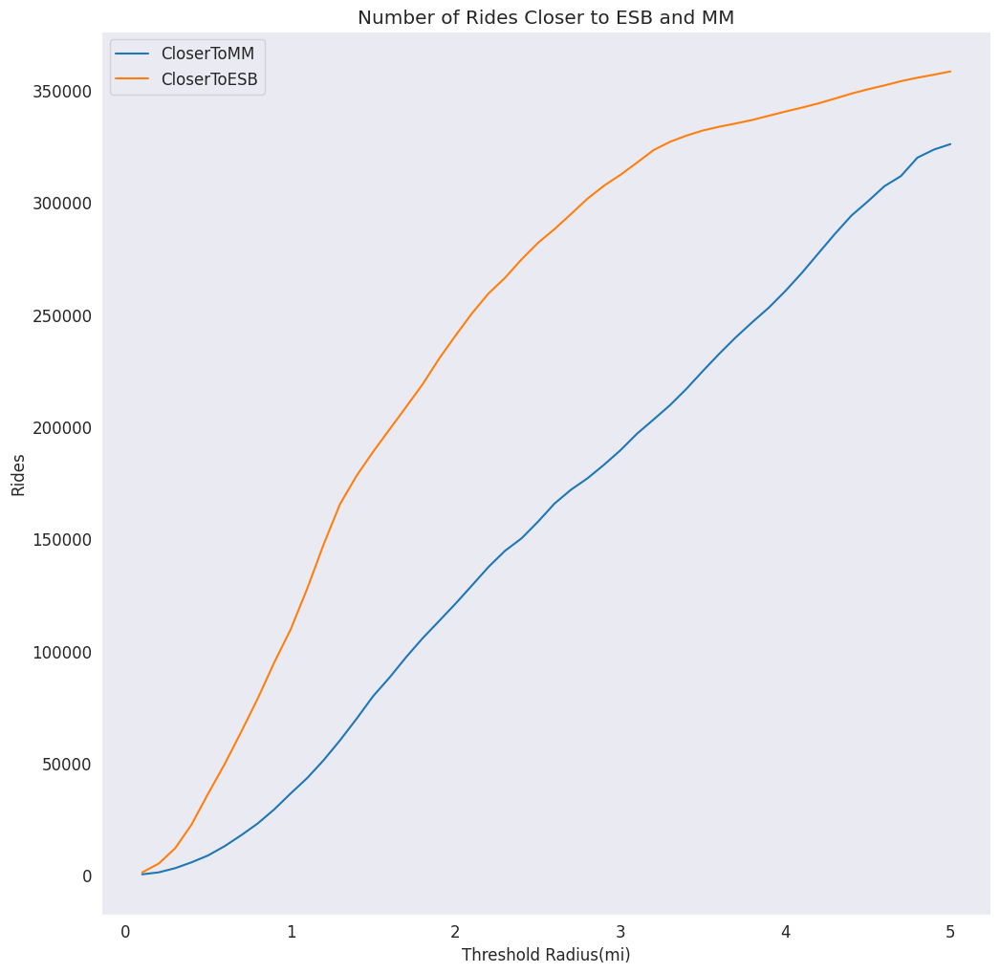

In [45]:
plt.figure(figsize=(12,12))
distance_data.plot(ax=plt.gca())
plt.title('Number of Rides Closer to ESB and MM')
plt.xlabel('Threshold Radius(mi)')
plt.ylabel('Rides')

###Displaying the map

In [46]:
#initilize the map around NYC and set the zoom level to 10
uber_map = folium.Map(location=metro_art_coordinates,zoom_start=10)

#lets mark MM and ESB on the map
folium.Marker(metro_art_coordinates,popup = "MM").add_to(uber_map)
folium.Marker(empire_state_building_coordinates,popup = "ESB").add_to(uber_map)

#convert to numpy array and plot it
Lat_Lon = uber_data[['Lat','Lon']].to_numpy()
folium.plugins.HeatMap(Lat_Lon,radius=10).add_to(uber_map)

#Displaying the map
uber_map

reduce the "Influence" of each point on the heatmap by using a weight of 0.5 (by default it is 1)

In [47]:
uber_data['Weight']=0.5

#Take on 10000 points to plot (Just to speed up things)
Lat_Lon = uber_data[['Lat','Lon','Weight']].to_numpy()

#Plotting
uber_map = folium.Map(metro_art_coordinates,zoom_start=10)
folium.plugins.HeatMap(Lat_Lon,radius=15).add_to(uber_map)
uber_map

In [48]:
i = uber_data[['Distance MM','Distance ESB']] < 0.25

i.head(10)

,Distance MM,Distance ESB
0,False,False
1,False,False
2,False,False
3,False,False
4,False,False
5,False,False
6,False,False
7,False,False
8,False,False
9,False,False


In [49]:
#Create a boolean mask to choose the rides that satisfy the 0.25 radius threshold
i=i.any(axis=1)

i[i==True]

,0
76,True
108,True
188,True
317,True
353,True
...,...
408272,True
408290,True
408295,True
408385,True


In [50]:
#Create a copy of the data
map_data = uber_data[i].copy()

#use a smaller weight
map_data['Weight'] = 0.1

#Restricting data to that before 8th july for faster calculations
map_data = uber_data[uber_data["BinnedHour"] < datetime.datetime(2014,7,8)].copy()

#Generate samples for each timestamp in "BinnedHour" (these are the points that are plotted for each timestamp)
map_data = map_data.groupby("BinnedHour").apply(lambda x: x[['Lat','Lon','Weight']].sample(int(len(x)/3)).to_numpy().tolist())

/tmp/ipython-input-3421149779.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  map_data = map_data.groupby("BinnedHour").apply(lambda x: x[['Lat','Lon','Weight']].sample(int(len(x)/3)).to_numpy().tolist())


In [51]:
map_data

,0
BinnedHour,
2014-06-01 00:00:00,"[[40.748, -73.9889, 0.5], [40.7258, -73.9904, ..."
2014-06-01 00:15:00,"[[40.7271, -73.9825, 0.5], [40.7173, -73.9568,..."
2014-06-01 00:30:00,"[[40.756, -73.9753, 0.5], [40.7632, -73.972, 0..."
2014-06-01 00:45:00,"[[40.665, -73.9932, 0.5], [40.3521, -74.6517, ..."
2014-06-01 01:00:00,"[[40.6785, -73.99, 0.5], [40.7361, -74.0014, 0..."
...,...
2014-06-30 22:45:00,"[[40.7801, -73.955, 0.5], [40.7682, -73.9823, ..."
2014-06-30 23:00:00,"[[40.7564, -73.9725, 0.5], [40.7342, -73.99, 0..."
2014-06-30 23:15:00,"[[40.8045, -73.9556, 0.5], [40.7709, -73.9677,..."


In [52]:
#The index to be passed on to heatmapwithtime needs to be a time series of the following format
data_hour_index = [x.strftime("%m%d%Y, %H:%M:%S") for x in map_data.index]

#convert to list to feed it to heatmapwithtime
date_hour_data = map_data.tolist()

#initialize map
uber_map = folium.Map(location=metro_art_coordinates,zoom_start=10)

In [54]:
uber_data

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight
0,2014-06-01 00:00:00,40.7293,-73.9920,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,3.772908,1.359325,0.5
1,2014-06-01 00:01:00,40.7131,-74.0097,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,5.183800,2.741757,0.5
2,2014-06-01 00:04:00,40.3461,-74.6610,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,47.272774,45.020108,0.5
3,2014-06-01 00:04:00,40.7555,-73.9833,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,1.956493,0.506038,0.5
4,2014-06-01 00:07:00,40.6880,-74.1831,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,13.122094,11.140215,0.5
...,...,...,...,...,...,...,...,...,...,...,...
408405,2014-06-23 18:19:00,40.7055,-74.0078,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,5.610560,3.179759,0.5
408406,2014-06-23 18:19:00,40.7651,-73.9674,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,1.011476,1.498529,0.5
408407,2014-06-23 18:19:00,40.7036,-74.0101,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,5.780174,3.346355,0.5
408408,2014-06-23 18:19:00,40.7408,-73.9917,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,3.053620,0.611446,0.5


In [55]:
weekends = weekly_data[['Saturday','Sunday']]

In [56]:
weekdays = weekly_data.drop(['Saturday','Sunday'],axis=1)

In [57]:
weekends = weekends.mean(axis=1)
weekdays = weekdays.mean(axis=1)

In [58]:
weekdays_weekends = pd.concat([weekdays,weekends],axis=1)
weekdays_weekends.columns = ['Weekdays','Weekends']

In [59]:
weekdays_weekends

,Weekdays,Weekends
Time,,
00:00:00,7.173333,26.400000
00:15:00,6.013333,23.350000
00:30:00,5.586667,19.783333
00:45:00,4.506667,18.966667
01:00:00,4.186667,17.100000
...,...,...
22:45:00,23.113333,24.883333
23:00:00,20.353333,22.866667
23:15:00,17.880000,19.750000


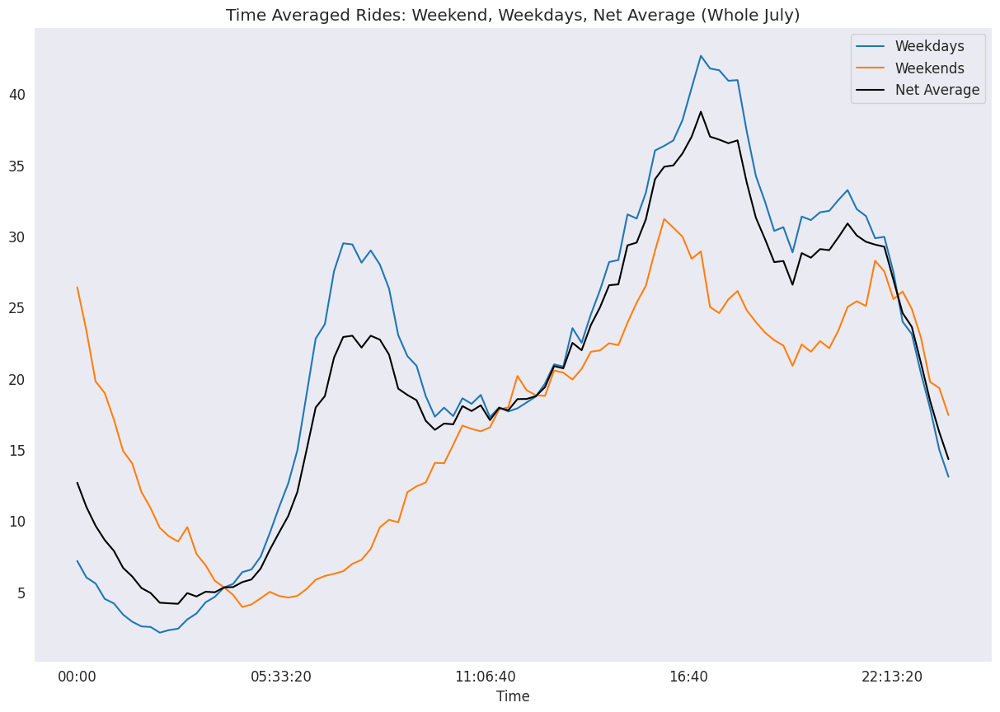

In [60]:
plt.figure(figsize=(15,10))
weekdays_weekends.plot(ax=plt.gca())
weekly_data.T.mean().plot(ax=plt.gca(),c = 'black',label='Net Average')
_=plt.title('Time Averaged Rides: Weekend, Weekdays, Net Average (Whole July)')
_=plt.legend()

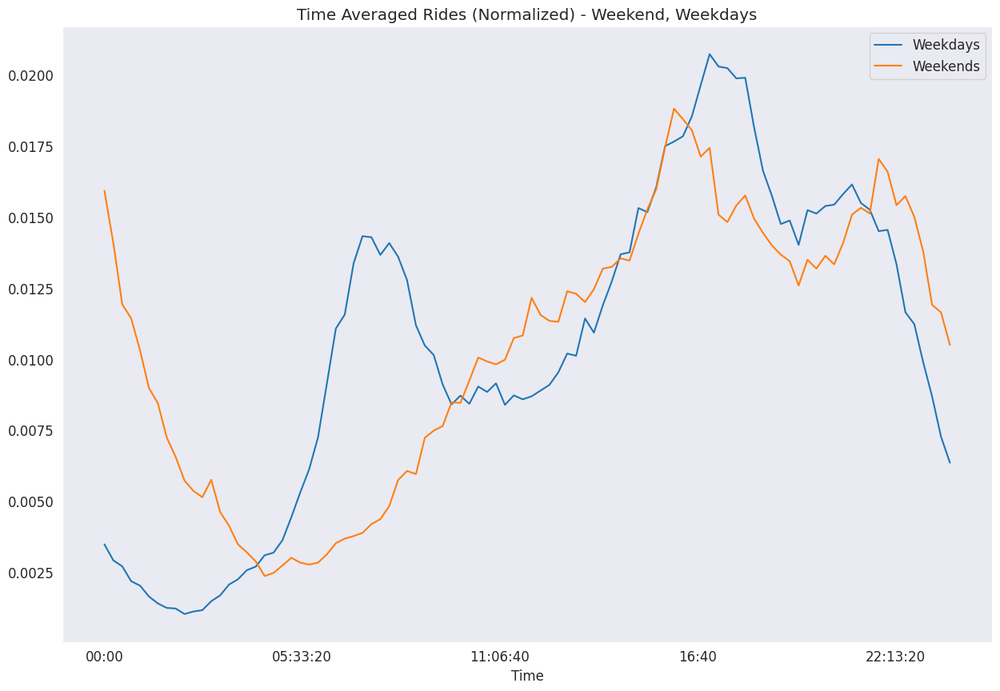

In [61]:
plt.figure(figsize=(15,10))
(weekdays_weekends/weekdays_weekends.sum()).plot(ax=plt.gca())
_=plt.title('Time Averaged Rides (Normalized) - Weekend, Weekdays')

In [62]:
#Grouping by date and time and creating a dataset that gives the total rides every 15 mins
for_ttest = uber_data.groupby(['Date','Time']).count()['Day'].reset_index(level=1)

In [63]:
#Total rides on each day in july
uber_data.groupby(['Date']).count()['Day']

,Day
Date,
2014-06-01,10829
2014-06-02,11635
2014-06-03,15410
2014-06-04,15652
2014-06-05,19301
2014-06-06,16624
2014-06-07,14158
2014-06-08,10782
2014-06-09,15723


In [64]:
#Normalizing the dataset by dividing rides in each time slot on a day by total number of rides on that day
for_ttest = pd.concat([for_ttest['Day']/uber_data.groupby(['Date']).count()['Day'],for_ttest['Time']],axis=1)

In [65]:
#renaming
for_ttest=for_ttest.rename(columns={'Day':'NormalizedRides'})

In [66]:
for_ttest

,NormalizedRides,Time
Date,,
2014-06-01,0.019115,00:00:00
2014-06-01,0.019946,00:15:00
2014-06-01,0.016160,00:30:00
2014-06-01,0.014221,00:45:00
2014-06-01,0.012282,01:00:00
...,...,...
2014-06-30,0.007455,22:45:00
2014-06-30,0.007317,23:00:00
2014-06-30,0.006489,23:15:00


In [67]:
for_ttest = pd.concat([for_ttest,pd.to_datetime(for_ttest.reset_index()['Date']).dt.day_name().to_frame().set_index(for_ttest.index).rename(columns={'Date':'Day'})],axis=1)

In [68]:
for_ttest

,NormalizedRides,Time,Day
Date,,,
2014-06-01,0.019115,00:00:00,Sunday
2014-06-01,0.019946,00:15:00,Sunday
2014-06-01,0.016160,00:30:00,Sunday
2014-06-01,0.014221,00:45:00,Sunday
2014-06-01,0.012282,01:00:00,Sunday
...,...,...,...
2014-06-30,0.007455,22:45:00,Monday
2014-06-30,0.007317,23:00:00,Monday
2014-06-30,0.006489,23:15:00,Monday


In [69]:
ttestvals = for_ttest.groupby('Time').apply(lambda x: ttest_ind(x[x['Day']<'Saturday']['NormalizedRides'],x[x['Day']>='Saturday']['NormalizedRides']))

/tmp/ipython-input-359204886.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  ttestvals = for_ttest.groupby('Time').apply(lambda x: ttest_ind(x[x['Day']<'Saturday']['NormalizedRides'],x[x['Day']>='Saturday']['NormalizedRides']))


In [70]:
ttestvals=pd.DataFrame(ttestvals.to_list(),index = ttestvals.index)
ttestvals

,statistic,pvalue
Time,,
00:00:00,-1.941525,0.062319
00:15:00,-1.981882,0.057386
00:30:00,-1.735080,0.093723
00:45:00,-2.046715,0.050177
01:00:00,-1.853532,0.074371
...,...,...
22:45:00,-0.887384,0.382431
23:00:00,-0.711308,0.482778
23:15:00,0.109949,0.913234


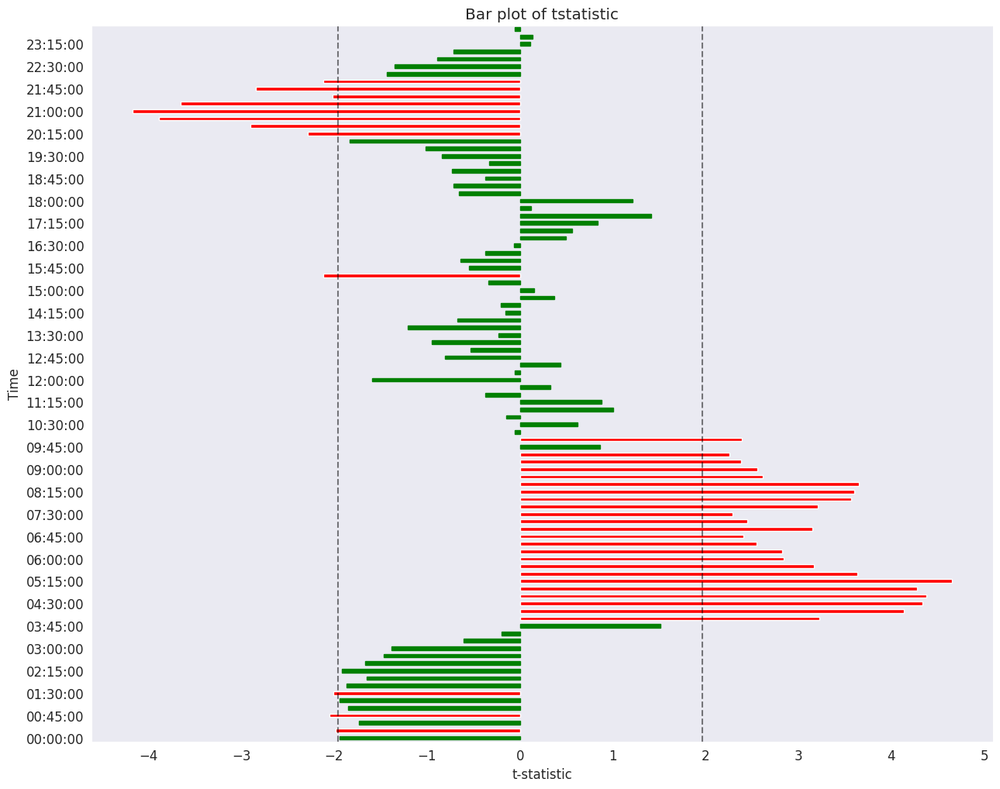

In [71]:
#Let's plot the "statistic" column
plt.figure(figsize=(15,12))
ax=ttestvals['statistic'].plot(kind='barh',color='red',ax=plt.gca())
plt.locator_params(axis='y', nbins=40)
plt.locator_params(axis='x', nbins=10)
plt.xlabel('t-statistic')
plt.axvline(x=1.96,alpha=0.5,color='black',linestyle='--')
plt.axvline(x=-1.96,alpha=0.5,color='black',linestyle='--')

for rect in ax.patches:
    if(abs(rect.get_width())<1.96):
        rect.set_color('green')
_=plt.title('Bar plot of tstatistic')

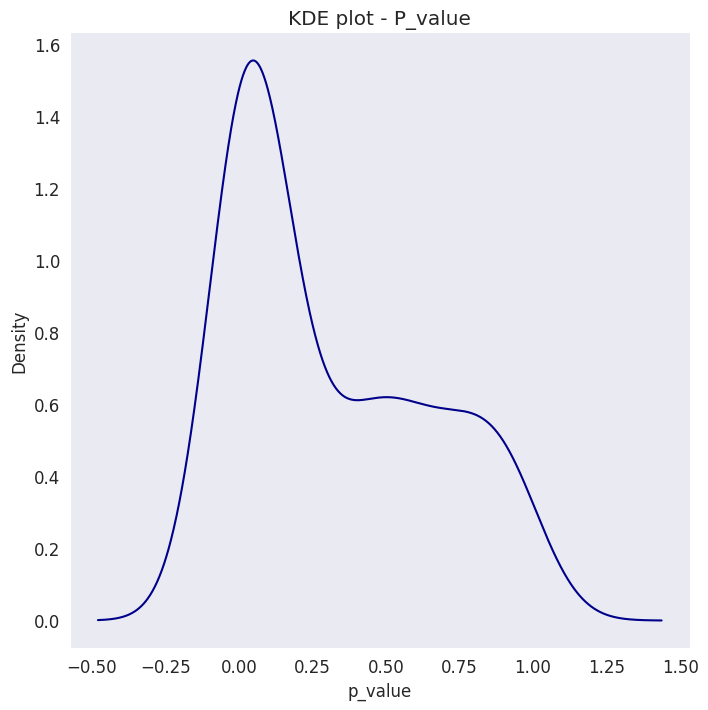

In [72]:
#KDE plot
plt.figure(figsize=(8,8))
ttestvals['pvalue'].plot(kind='kde',color='darkblue',ax=plt.gca())
plt.title('KDE plot - P_value')
_=plt.xlabel('p_value')

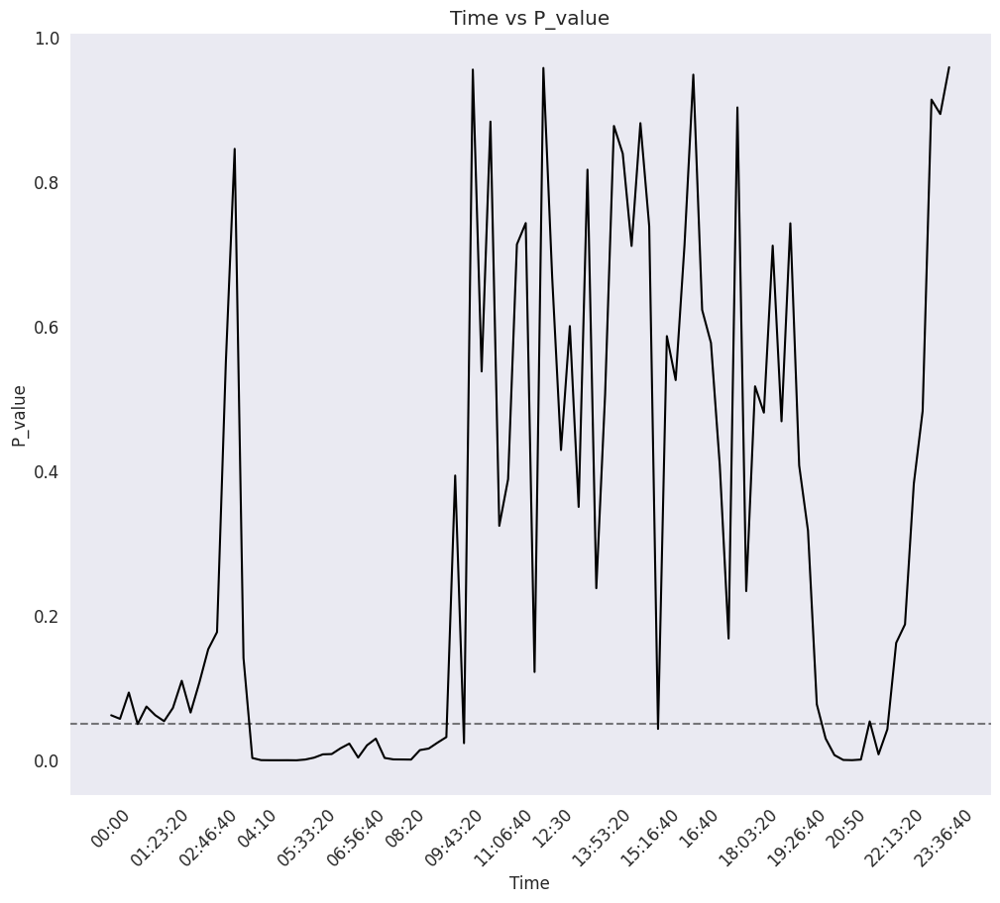

In [73]:
#P-value distribution:

plt.figure(figsize=(12,10))
ax=ttestvals['pvalue'].plot(kind='line',color='black',ax=plt.gca())
plt.axhline(y=0.05,alpha=0.5,color='black',linestyle='--')
plt.locator_params(axis='x',nbins=20)
for item in plt.gca().get_xticklabels():
    item.set_rotation(45)

_=plt.title('Time vs P_value')
_=plt.ylabel('P_value')

##Checking Relations in Data

In [74]:
uber_data

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight
0,2014-06-01 00:00:00,40.7293,-73.9920,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,3.772908,1.359325,0.5
1,2014-06-01 00:01:00,40.7131,-74.0097,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,5.183800,2.741757,0.5
2,2014-06-01 00:04:00,40.3461,-74.6610,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,47.272774,45.020108,0.5
3,2014-06-01 00:04:00,40.7555,-73.9833,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,1.956493,0.506038,0.5
4,2014-06-01 00:07:00,40.6880,-74.1831,B02512,2014-06-01 00:00:00,Sunday,2014-06-01,00:00:00,13.122094,11.140215,0.5
...,...,...,...,...,...,...,...,...,...,...,...
408405,2014-06-23 18:19:00,40.7055,-74.0078,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,5.610560,3.179759,0.5
408406,2014-06-23 18:19:00,40.7651,-73.9674,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,1.011476,1.498529,0.5
408407,2014-06-23 18:19:00,40.7036,-74.0101,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,5.780174,3.346355,0.5
408408,2014-06-23 18:19:00,40.7408,-73.9917,B02617,2014-06-23 18:15:00,Monday,2014-06-23,18:15:00,3.053620,0.611446,0.5


In [75]:
#create a copy
df = uber_data.copy()

In [76]:
#get numbers of each weekday
df['WeekDay']=df['Date/Time'].dt.weekday

In [77]:
#Convert datetime to float. egs: 1:15AM will be 1.25, 12:45 will be 12.75 etc
def func(x):
    hr = float(x.hour)
    minute = int(x.minute/15)
    return hr + minute/4
df['Time']=df['Date/Time'].apply(func)

In [78]:
#Get the day number, removing month and year
df['Day']=df['Date/Time'].dt.day
df

,Date/Time,Lat,Lon,Base,BinnedHour,Day,Date,Time,Distance MM,Distance ESB,Weight,WeekDay
0,2014-06-01 00:00:00,40.7293,-73.9920,B02512,2014-06-01 00:00:00,1,2014-06-01,0.00,3.772908,1.359325,0.5,6
1,2014-06-01 00:01:00,40.7131,-74.0097,B02512,2014-06-01 00:00:00,1,2014-06-01,0.00,5.183800,2.741757,0.5,6
2,2014-06-01 00:04:00,40.3461,-74.6610,B02512,2014-06-01 00:00:00,1,2014-06-01,0.00,47.272774,45.020108,0.5,6
3,2014-06-01 00:04:00,40.7555,-73.9833,B02512,2014-06-01 00:00:00,1,2014-06-01,0.00,1.956493,0.506038,0.5,6
4,2014-06-01 00:07:00,40.6880,-74.1831,B02512,2014-06-01 00:00:00,1,2014-06-01,0.00,13.122094,11.140215,0.5,6
...,...,...,...,...,...,...,...,...,...,...,...,...
408405,2014-06-23 18:19:00,40.7055,-74.0078,B02617,2014-06-23 18:15:00,23,2014-06-23,18.25,5.610560,3.179759,0.5,0
408406,2014-06-23 18:19:00,40.7651,-73.9674,B02617,2014-06-23 18:15:00,23,2014-06-23,18.25,1.011476,1.498529,0.5,0
408407,2014-06-23 18:19:00,40.7036,-74.0101,B02617,2014-06-23 18:15:00,23,2014-06-23,18.25,5.780174,3.346355,0.5,0
408408,2014-06-23 18:19:00,40.7408,-73.9917,B02617,2014-06-23 18:15:00,23,2014-06-23,18.25,3.053620,0.611446,0.5,0


In [79]:
#Remove unwanted columns that were created for visualization
df = df.drop(['Date/Time','BinnedHour','Date','Distance MM','Distance ESB','Lat','Lon'],axis=1)

In [80]:
#create a redundant columns for easy counting of tolal rides
df['DropMe']=1

In [81]:
#count the number of rides for a given day, weekday number, time and base
df = df.groupby(['Day','WeekDay','Time','Base']).count()['DropMe'].reset_index().rename(columns={'DropMe':'Rides'})
df

,Day,WeekDay,Time,Base,Rides
0,1,6,0.00,B02512,11
1,1,6,0.00,B02598,111
2,1,6,0.00,B02617,85
3,1,6,0.25,B02512,11
4,1,6,0.25,B02598,119
...,...,...,...,...,...
7857,30,0,23.25,B02598,44
7858,30,0,23.50,B02512,5
7859,30,0,23.50,B02598,29
7860,30,0,23.75,B02512,1


In [82]:
df['Weekend']=df.apply(lambda x: 1 if(x['WeekDay']>4) else 0,axis=1)

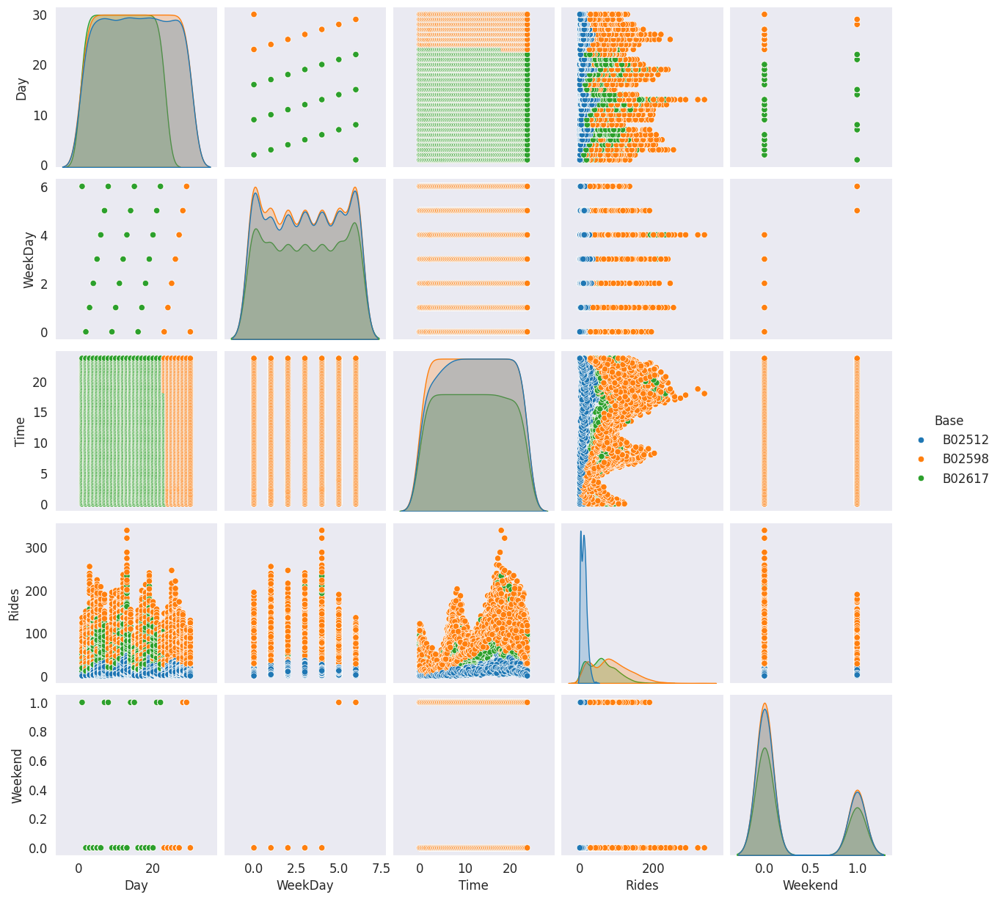

In [83]:
#Let's visualize a pairplot
sns.pairplot(df,hue='Base')

<Figure size 640x480 with 0 Axes>

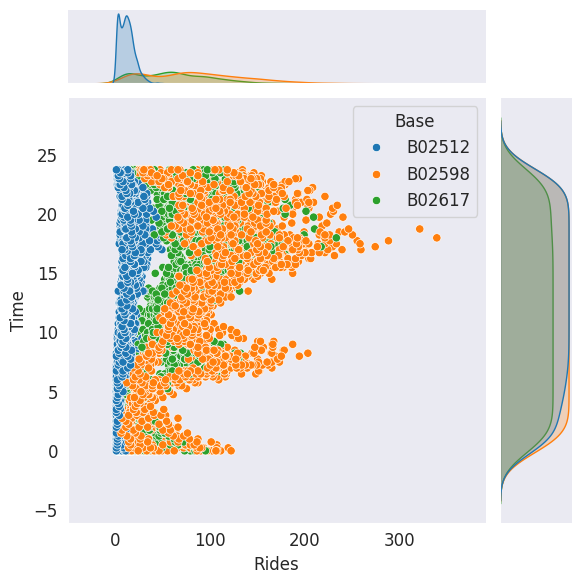

In [84]:
#jointplot of Rides vs Time

plt.figure()
_=sns.jointplot(x='Rides',y='Time',data = df,hue='Base')